# Chapter 5: Image Enhancement

## Problems

## 1. Image Enhancement Filters with PIL for noise removal and smoothing

### 1.1  BLUR Filter to remove Salt & Pepper Noise

In [3]:
from IPython.core.display import display,HTML
display(HTML('<style>.prompt{width: 0px; min-width: 0px; visibility: collapse}</style>'))

In [2]:
# comment out the following line of code only if you are not running from jupyter notebook
%matplotlib inline

import numpy as np
import matplotlib.pylab as plt
from PIL import Image, ImageFilter
from copy import deepcopy

In [8]:
def plot_image(image, title=None, sz=20):
    plt.imshow(image)
    plt.title(title, size=sz)
    plt.axis('off')

In [8]:
def add_noise(im, prop_noise, salt=True, pepper=True):
    im = deepcopy(im)
    n = int(im.width * im.height * prop_noise)
    x, y = np.random.randint(0, im.width, n), np.random.randint(0, im.height, n)
    for (x,y) in zip(x,y):
        im.putpixel((x, y), \
        # generate salt-and-pepper noise
        ((0,0,0) if np.random.rand() < 0.5 else (255,255,255)) if salt and pepper \
        else (255,255,255) if salt \
        else (0, 0, 0)) # if pepper
    return im

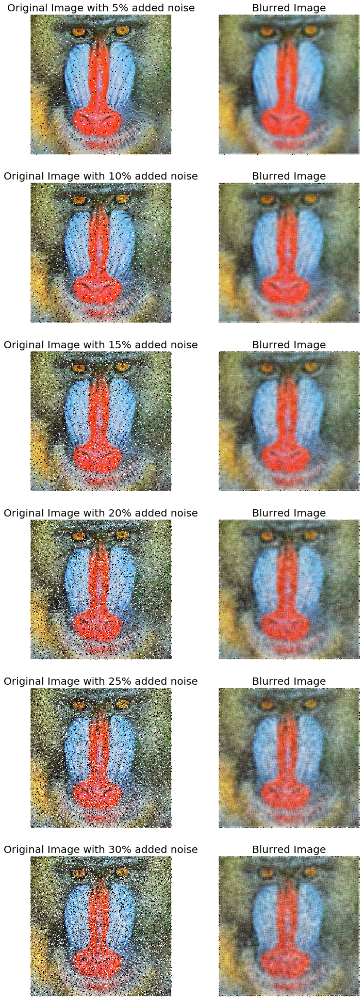

In [9]:
orig = Image.open('images/Img_05_01.jpg')
i = 1
plt.figure(figsize=(12,35))
for prop_noise in np.linspace(0.05,0.3,6):
 # choose random locations inside image
 im = add_noise(orig, prop_noise)
 plt.subplot(6,2,i), plot_image(im, 'Original Image with ' + str(int(100*prop_noise)) + '% added noise')
 im1 = im.filter(ImageFilter.BLUR)
 plt.subplot(6,2,i+1), plot_image(im1, 'Blurred Image')
 i += 2

plt.show()

### 1.2 Gaussian BLUR Filter to remove Salt & Pepper Noise

In [10]:
im = Image.open('images/Img_05_01.jpg')
im = add_noise(im, prop_noise = 0.2)

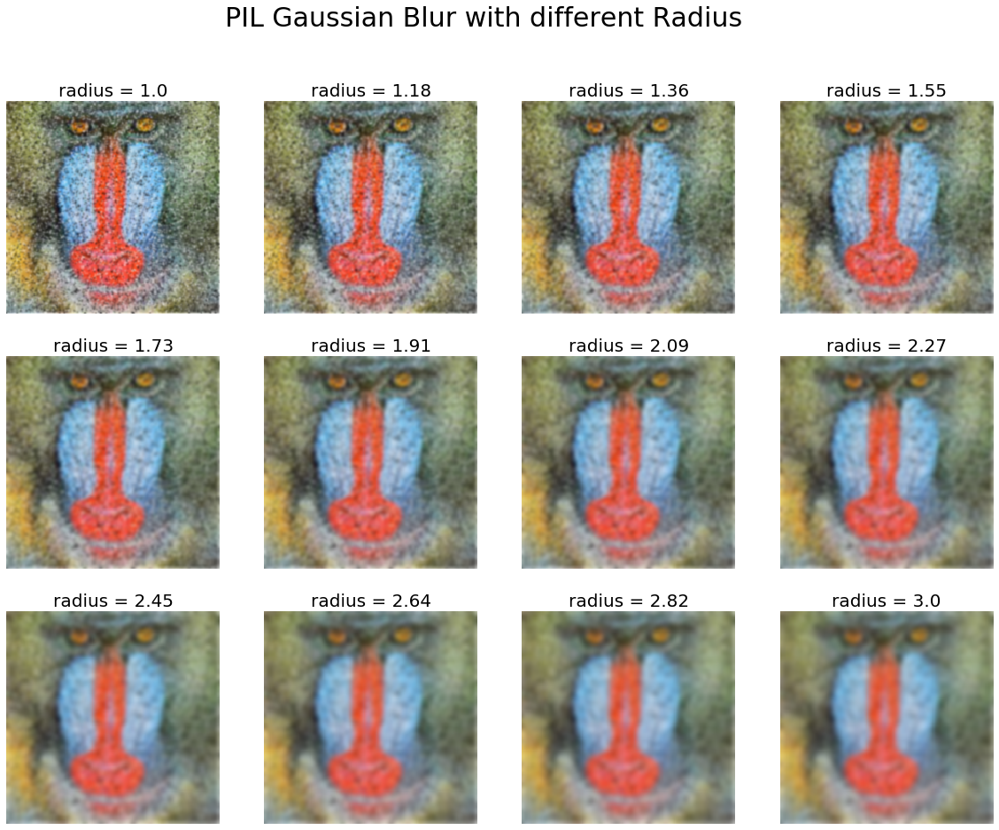

In [11]:
plt.figure(figsize=(20,15))
i = 1
for radius in np.linspace(1, 3, 12): 
    im1 = im.filter(ImageFilter.GaussianBlur(radius))
    plt.subplot(3,4,i)
    plot_image(im1, 'radius = ' + str(round(radius,2)))
    i += 1
plt.suptitle('PIL Gaussian Blur with different Radius', size=30)
plt.show()

### 1.3 Median Filter to remove Salt & Pepper Noise

In [15]:
im = Image.open('images/Img_05_02.jpg')
im = add_noise(im, prop_noise = 0.1)

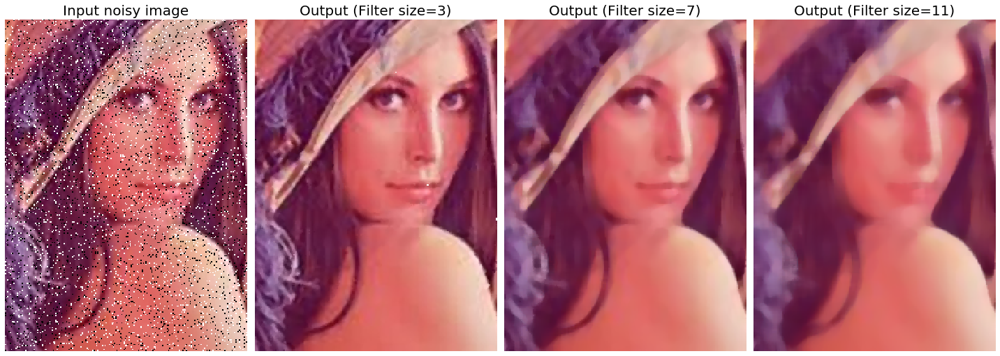

In [20]:
plt.figure(figsize=(20,10))
plt.subplot(1,4,1)
plot_image(im, 'Input noisy image')
i = 2
for sz in [3,7,11]:
 im1 = im.filter(ImageFilter.MedianFilter(size=sz)) 
 plt.subplot(1,4,i), plot_image(im1, 'Output (Filter size=' + str(sz) + ')', 20)
 i += 1
plt.tight_layout()
plt.show()

### 1.4 Max, Min and Mode filters to remove outliers from image

#### Min filter

In [21]:
orig = Image.open('images/Img_05_11.jpg')
im = add_noise(orig, prop_noise = 0.2, pepper=False)

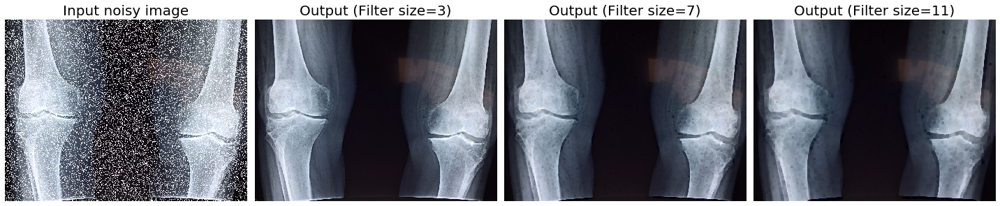

In [22]:
plt.figure(figsize=(20,10))
plt.subplot(1,4,1)
plot_image(im, 'Input noisy image')
i = 2
for sz in [3,7,11]:
 im1 = im.filter(ImageFilter.MinFilter(size=sz)) 
 plt.subplot(1,4,i), plot_image(im1, 'Output (Filter size=' + str(sz) + ')')
 i += 1
plt.tight_layout()
plt.show()

#### Max filter

In [186]:
im = add_noise(orig, prop_noise = 0.3, salt=False)

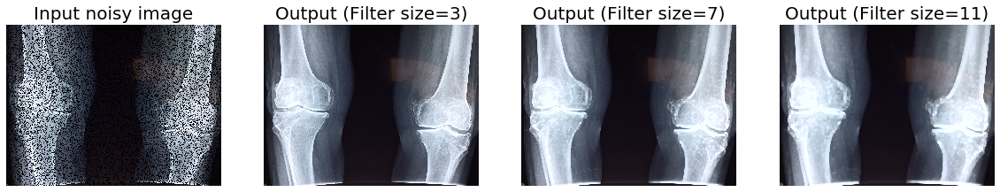

In [187]:
plt.figure(figsize=(20,10))
plt.subplot(1,4,1)
plot_image(im, 'Input noisy image')
i = 2
for sz in [3,7,11]:
 im1 = im.filter(ImageFilter.MaxFilter(size=sz)) 
 plt.subplot(1,4,i), plot_image(im1, 'Output (Filter size=' + str(sz) + ')')
 i += 1
plt.show()

#### Mode filter

In [192]:
orig = Image.open('images/Img_05_20.jpg')
im = add_noise(orig, prop_noise = 0.1)

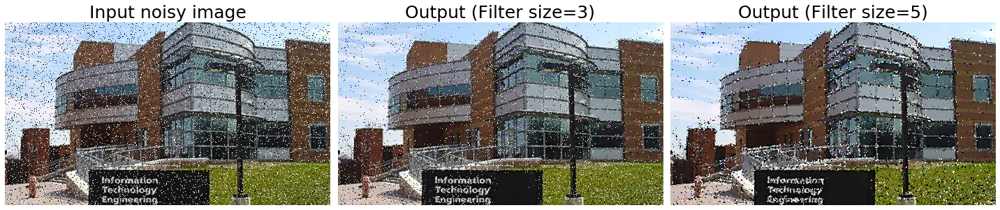

In [205]:
plt.figure(figsize=(20,20))
plt.subplot(1,3,1)
plot_image(im, 'Input noisy image', 25)
i = 2
for sz in [3,5]:
 im1 = im.filter(ImageFilter.ModeFilter(size=sz)) 
 plt.subplot(1,3,i), plot_image(im1, 'Output (Filter size=' + str(sz) + ')', 25)
 i += 1
plt.tight_layout()
plt.show()

### 1.5  Progressive Application of Gaussian Blur, Median, Mode and Max Filters on an image

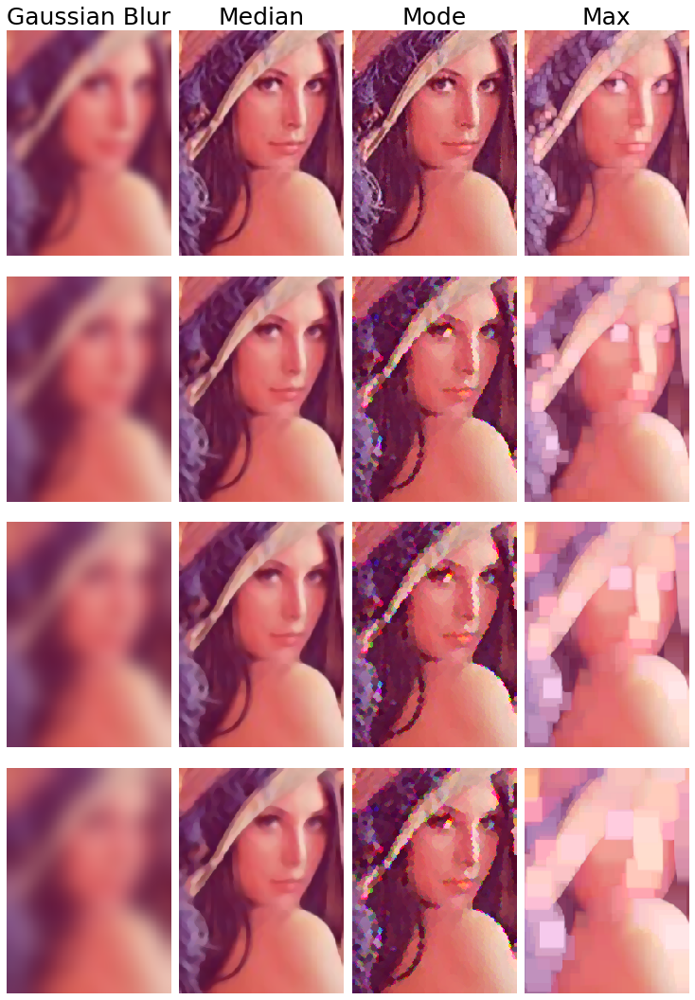

In [26]:
im = Image.open('images/Img_05_02.jpg')
plt.figure(figsize=(10,15))
plt.subplots_adjust(0,0,1,0.95,0.05,0.05)
im1 = im.copy()
sz = 5
for i in range(8):
 im1 = im1.filter(ImageFilter.GaussianBlur(radius=sz)) 
 if i % 2 == 0:
    plt.subplot(4,4,4*i//2+1), plot_image(im1, 'Gaussian Blur' if i == 0 else None, 25)
im1 = im.copy()
for i in range(8):
 im1 = im1.filter(ImageFilter.MedianFilter(size=sz)) 
 if i % 2 == 0:
    plt.subplot(4,4,4*i//2+2), plot_image(im1, 'Median' if i == 0 else None, 25)
im1 = im.copy()
for i in range(8):
 im1 = im1.filter(ImageFilter.ModeFilter(size=sz)) 
 if i % 2 == 0:
    plt.subplot(4,4,4*i//2+3), plot_image(im1, 'Mode' if i == 0 else None, 25)
im1 = im.copy()
for i in range(8):
 im1 = im1.filter(ImageFilter.MaxFilter(size=sz)) 
 if i % 2 == 0:
    plt.subplot(4,4,4*i//2+4), plot_image(im1, 'Max' if i == 0 else None, 25)
plt.show()

## 2. Unsharp masking to Sharpen an Image

### 2.1 With scikit-image filters module

In [208]:
#! pip install --upgrade scikit-image
#import skimage
#skimage.filters.__all__
import numpy as np
import matplotlib.pylab as plt
from skimage.io import imread
from skimage.filters import unsharp_mask

In [209]:
im = imread('images/Img_05_04.jpg')
im1 = unsharp_mask(im, radius=1, amount=1)
im2 = unsharp_mask(im, radius=5, amount=2)
im3 = unsharp_mask(im, radius=20, amount=3)

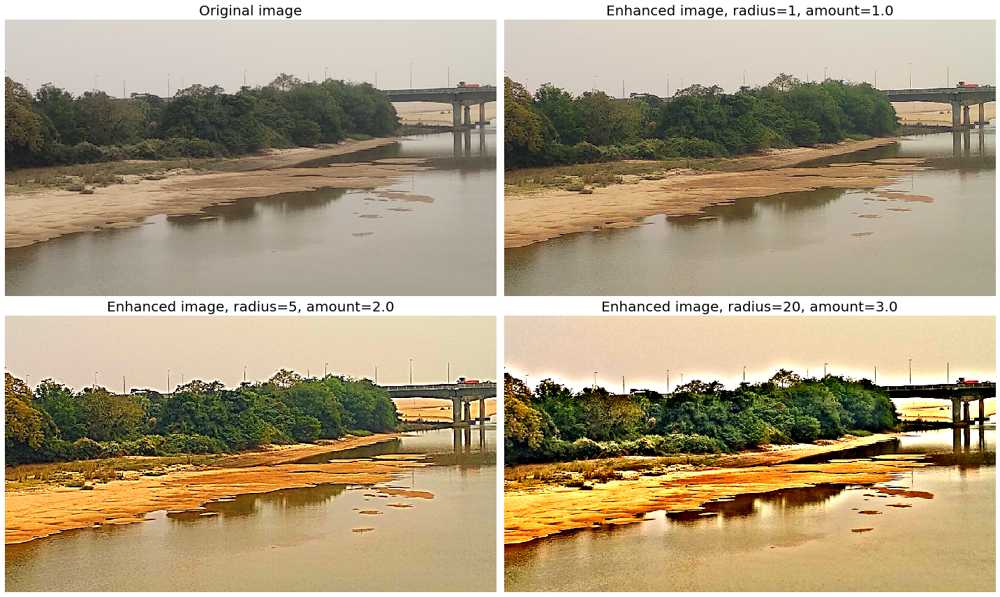

In [210]:
fig, axes = plt.subplots(nrows=2, ncols=2, sharex=True, sharey=True, figsize=(20, 12))
axes = axes.ravel()
axes[0].set_title('Original image', size=20), axes[0].imshow(im)
axes[1].set_title('Enhanced image, radius=1, amount=1.0', size=20), axes[1].imshow(im1)
axes[2].set_title('Enhanced image, radius=5, amount=2.0', size=20), axes[2].imshow(im2)
axes[3].set_title('Enhanced image, radius=20, amount=3.0', size=20), axes[3].imshow(im3)
for ax in axes:
 ax.axis('off')
fig.tight_layout()
plt.show()

### 2.2 With PIL ImageFilter module

In [147]:
from PIL import Image, ImageFilter
im = Image.open('images/Img_05_05.jpg')

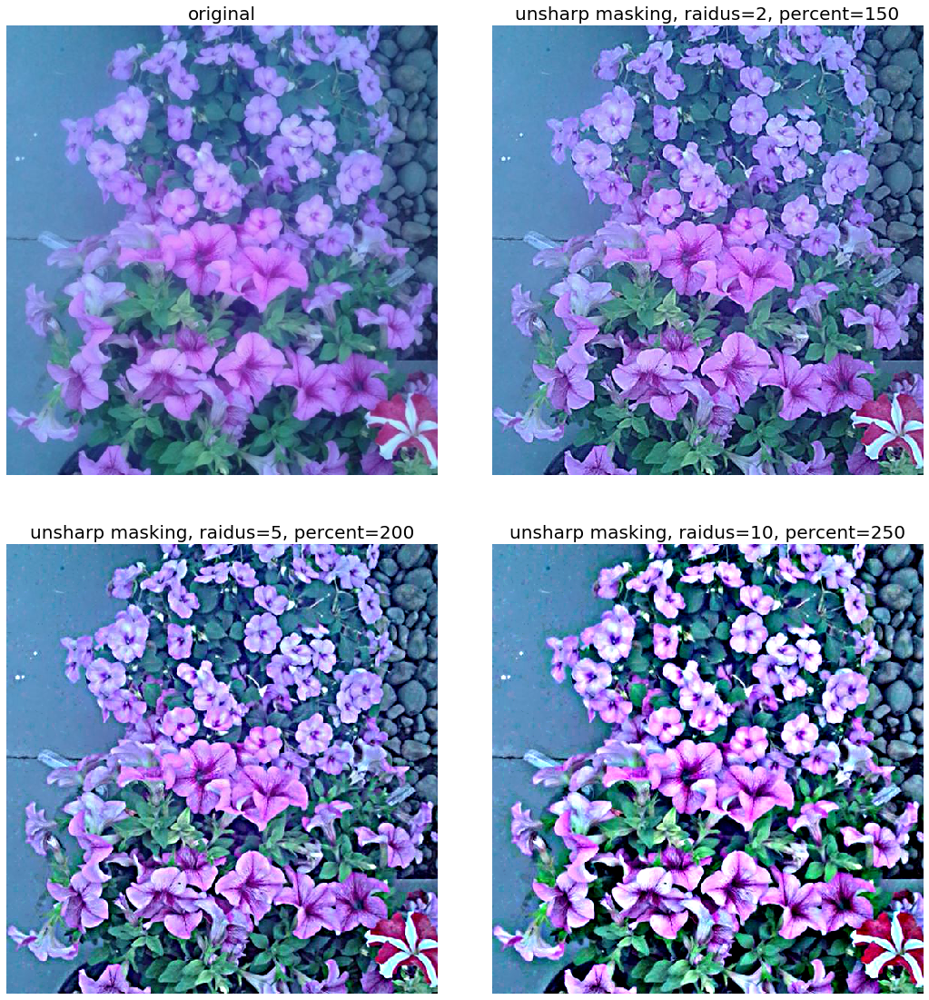

In [154]:
plt.figure(figsize=(15,16))
plt.subplot(221), plot_image(im, 'original')
im1 = im.filter(ImageFilter.UnsharpMask(radius=2, percent=150))
plt.subplot(222), plot_image(im1, 'unsharp masking, radius=2, percent=150')
im1 = im.filter(ImageFilter.UnsharpMask(radius=5, percent=200))
plt.subplot(223), plot_image(im1, 'unsharp masking, radius=5, percent=200')
im1 = im.filter(ImageFilter.UnsharpMask(radius=10, percent=250))
plt.subplot(224), plot_image(im1, 'unsharp masking, radius=10, percent=250')
plt.tight_layout()
plt.show()

### 2.3 Laplacian Sharpening with SimpleITK

In [31]:
import SimpleITK as sitk
import numpy as np
import matplotlib.pylab as plt

In [86]:
image = sitk.ReadImage('images/Img_05_20.jpg', sitk.sitkFloat32)

In [106]:
filt = sitk.UnsharpMaskImageFilter() 
filt.SetAmount(1.5) # typically set between 1 and 2
filt.SetSigmas(0.15)
sharpened = filt.Execute(image)

In [107]:
np_image = sitk.GetArrayFromImage(image)
np_image = np_image / np_image.max()
np_sharpened = sitk.GetArrayFromImage(sharpened)
np_sharpened = np_sharpened / np_sharpened.max()

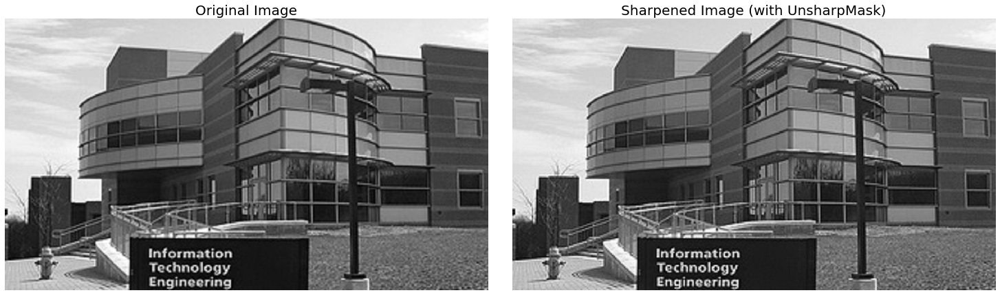

In [108]:
plt.figure(figsize=(20,10))
plt.gray()
plt.subplots_adjust(0,0,1,1,0.05,0.05)
plt.subplot(121), plot_image(np_image, 'Original Image')
plt.subplot(122), plot_image(np_sharpened, 'Sharpened Image (with UnsharpMask)')
plt.show()

### 2.4 Implementing Unsharp Mask with opencv-python

In [12]:
import cv2

im = cv2.imread("images/Img_05_13.png")
im_smoothed = cv2.GaussianBlur(im, (11,11), 10, 10)

In [114]:
im1 = cv2.addWeighted(im, 1.0 + 3.0, im_smoothed, -3.0, 0) # im1 = im + 3.0*(im - im_smoothed)

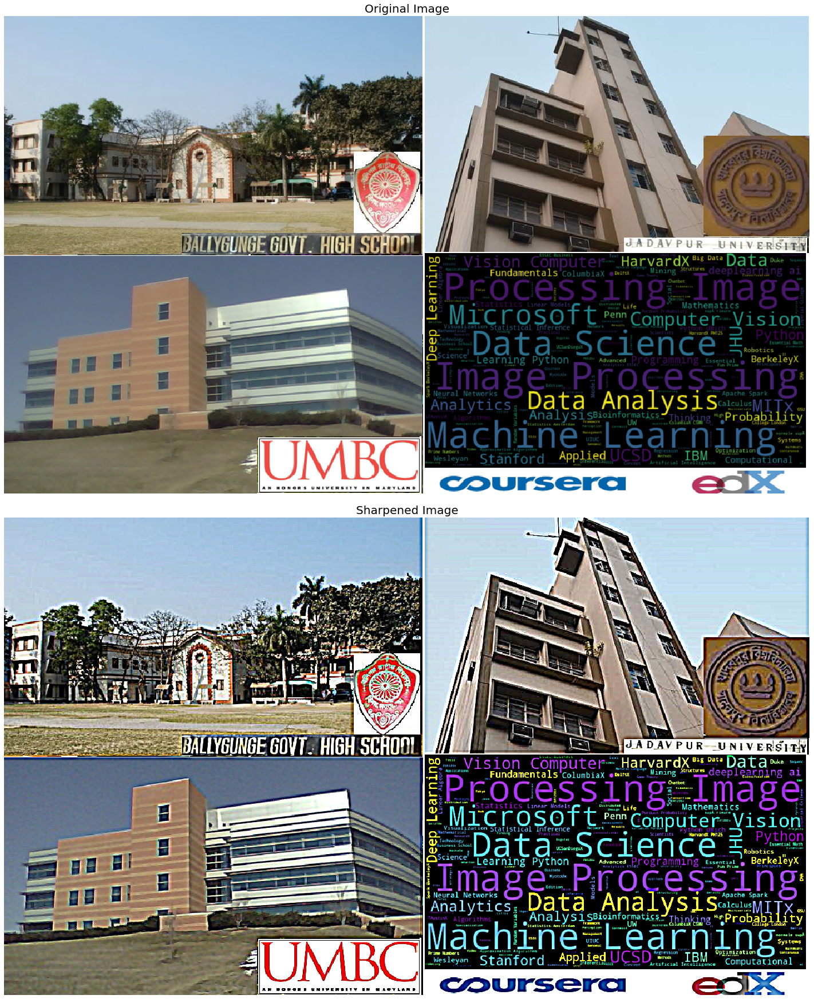

In [115]:
plt.figure(figsize=(20,25))
plt.subplots_adjust(0,0,1,0.95,0.05,0.05)
plt.subplot(211), plot_image(cv2.cvtColor(im, cv2.COLOR_BGR2RGB), 'Original Image')
plt.subplot(212), plot_image(cv2.cvtColor(im1, cv2.COLOR_BGR2RGB), 'Sharpened Image')
plt.show()

## 3. Averaging of Images to remove Random Noise

In [143]:
from skimage import img_as_float
from skimage.util import random_noise
from skimage.metrics import peak_signal_noise_ratio
from skimage.io import imread
import matplotlib.pylab as plt
import numpy as np

In [144]:
im = img_as_float(imread('images/Img_05_06.jpg')) # original image
n = 100
images = np.zeros((n, im.shape[0], im.shape[1], im.shape[2]))
sigma = 0.2
for i in range(n):
    images[i,...] = random_noise(im, var=sigma**2)

In [146]:
im_mean = images.mean(axis=0)
im_median = np.median(images, axis=0)

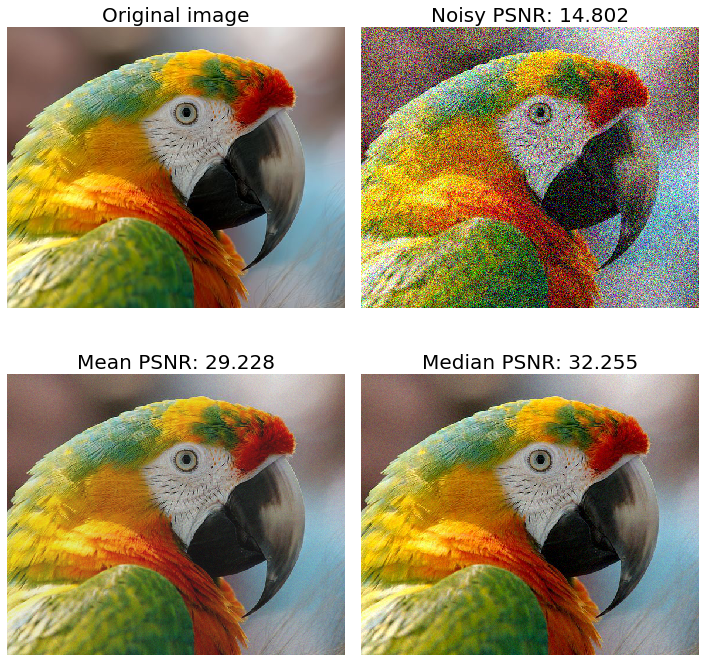

In [147]:
plt.figure(figsize=(10,10))
plt.subplots_adjust(left=.02, right=.98, bottom=.001, top=.96, wspace=.05, hspace=.01)
plt.subplot(221), plot_image(im, 'Original image')
plt.subplot(222), plot_image(images[0], 'Noisy PSNR: ' + str(round(peak_signal_noise_ratio(im, images[0]),3)))
plt.subplot(223), plot_image(im_mean, 'Mean PSNR: ' + str(round(peak_signal_noise_ratio(im, im_mean),3)))
plt.subplot(224), plot_image(im_median, 'Median PSNR: ' + str(round(peak_signal_noise_ratio(im, im_median),3)))
plt.show()

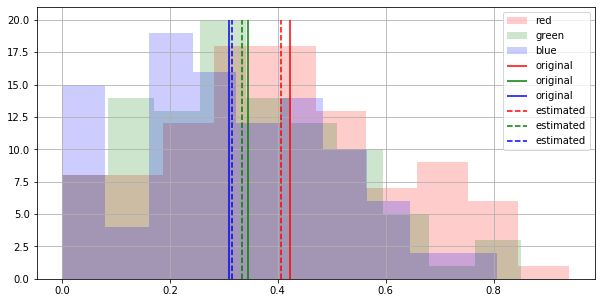

In [151]:
plt.figure(figsize=(10,5))
plt.hist(images[:,100,100,0], color='red', alpha=0.2, label='red')
plt.hist(images[:,100,100,1], color='green', alpha=0.2, label='green')
plt.hist(images[:,100,100,2], color='blue', alpha=0.2, label='blue')
plt.vlines(im[100,100,0], 0, 20, color='red', label='original')
plt.vlines(im[100,100,1], 0, 20, color='green', label='original')
plt.vlines(im[100,100,2], 0, 20, color='blue', label='original')
plt.vlines(im_mean[100,100,0], 0, 20, color='red', linestyles='dashed', label='estimated')
plt.vlines(im_mean[100,100,1], 0, 20, color='green', linestyles='dashed', label='estimated')
plt.vlines(im_mean[100,100,2], 0, 20, color='blue', linestyles='dashed', label='estimated')
plt.legend()
plt.grid()
plt.show()

## 4. Image Denoising with Curvature-Driven Algorithms

In [ ]:
import SimpleITK as sitk
import matplotlib.pylab as plt

img = sitk.ReadImage('images/Img_05_11.png', sitk.sitkFloat64)

In [139]:
normfilter = sitk.NormalizeImageFilter()
caster = sitk.CastImageFilter()
caster.SetOutputPixelType(sitk.sitkFloat64)
        
tkfilter = sitk.ShotNoiseImageFilter()
tkfilter.SetScale(0.2)
img_noisy = tkfilter.Execute (img)
img_noisy = sitk.RescaleIntensity(img_noisy)

In [140]:
tkfilter = sitk.CurvatureFlowImageFilter() 
tkfilter.SetNumberOfIterations(50)
tkfilter.SetTimeStep(0.1)
img_res_TK = tkfilter.Execute(img_noisy)

In [ ]:
tkfilter = sitk.MinMaxCurvatureFlowImageFilter() 
tkfilter.SetNumberOfIterations(50)
tkfilter.SetTimeStep(0.1)
tkfilter.SetStencilRadius(4)
img_res_TK1 = tkfilter.Execute(img_noisy)
img_res_TK1 = sitk.RescaleIntensity(img_res_TK1)

#### Anisotropic Diffusion

In [141]:
tkfilter = sitk.CurvatureAnisotropicDiffusionImageFilter()
tkfilter.SetNumberOfIterations(100);
tkfilter.SetTimeStep(0.05);
tkfilter.SetConductanceParameter(3);
img_res_TK2 = tkfilter.Execute(img_noisy)
#img_res_TK1 = sitk.RescaleIntensity(img_res_TK1) 

In [ ]:
tkfilter = sitk.GradientAnisotropicDiffusionImageFilter()
tkfilter.SetNumberOfIterations(100);
tkfilter.SetTimeStep(0.05);
tkfilter.SetConductanceParameter(3);
img_res_TK3 = tkfilter.Execute(img_noisy)

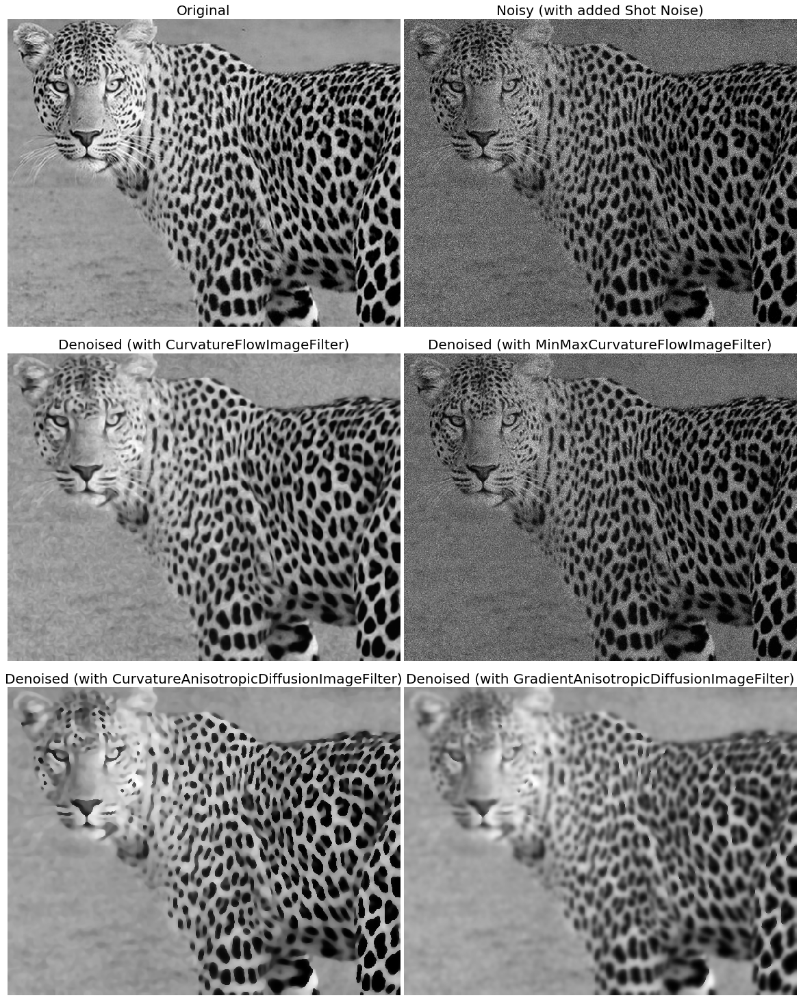

In [142]:
plt.figure(figsize=(16,20))
plt.gray()
plt.subplots_adjust(0,0,1,1,0.01,0.05)
plt.subplot(321), plt.imshow(sitk.GetArrayFromImage(img)), plt.axis('off'), plt.title('Original', size=20)
plt.subplot(322), plt.imshow(sitk.GetArrayFromImage(img_noisy)), plt.axis('off'), plt.title('Noisy (with added Shot Noise)', size=20)
plt.subplot(323), plt.imshow(sitk.GetArrayFromImage(img_res_TK)), plt.axis('off'), plt.title('Denoised (with CurvatureFlowImageFilter)', size=20)
plt.subplot(324), plt.imshow(sitk.GetArrayFromImage(img_res_TK1)), plt.axis('off'), plt.title('Denoised (with MinMaxCurvatureFlowImageFilter)', size=20)
plt.subplot(325), plt.imshow(sitk.GetArrayFromImage(img_res_TK2)), plt.axis('off'), plt.title('Denoised (with CurvatureAnisotropicDiffusionImageFilter)', size=20)
plt.subplot(326), plt.imshow(sitk.GetArrayFromImage(img_res_TK3)), plt.axis('off'), plt.title('Denoised (with GradientAnisotropicDiffusionImageFilter)', size=20)
plt.show()

## 5. Contrast Strectching / Histogram Equalization with opencv-python

In [6]:
import numpy as np
import matplotlib.pylab as plt
import cv2

In [7]:
def plot_hist(img, col='r'):
    hist,bins = np.histogram(img.flatten(),256,[0,256])
    cdf = hist.cumsum()
    cdf_normalized = cdf * hist.max()/ cdf.max()
    plt.plot(cdf_normalized, color = col)
    plt.hist(img.flatten(),256,[0,256], color = col, alpha = 0.1)
    plt.xlim([0,256])
    plt.title('CDF and histogram of the color channels', size=20)
    #plt.legend(('cdf','histogram'), loc = 'upper left')
    return bins, cdf

In [13]:
def plot_img_hist(img, title):
    plt.figure(figsize=(20,10))
    plt.subplot(121), plot_image(img, title)
    plt.subplot(122), plot_hist(img[...,0], 'r'), plot_hist(img[...,1], 'g'), plot_hist(img[...,2], 'b')
    plt.show()

In [51]:
img = cv2.imread('images/Img_05_07.jpg')
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

In [52]:
img2 = img.copy()
for i in range(3):
    hist,bins = np.histogram(img[...,i].flatten(),256,[0,256])
    cdf = hist.cumsum()
    cdf_m = np.ma.masked_equal(cdf,0)
    cdf_m = (cdf_m - cdf_m.min())*255/(cdf_m.max()-cdf_m.min())
    #cdf_m = 255 * cdf / cdf[-1] # normalize
    cdf = np.ma.filled(cdf_m,0).astype('uint8')
    img2[...,i] = cdf[img[...,i]]
    # use linear interpolation of cdf to find new pixel values
    #img2[...,i] = np.reshape(np.interp(img[...,i].flatten(),bins[:-1],cdf), img[...,i].shape)

In [53]:
img_lab = cv2.cvtColor(img, cv2.COLOR_RGB2LAB)
equ = img_lab.copy()
equ[...,0] = cv2.equalizeHist(equ[...,0])
equ = np.clip(cv2.cvtColor(equ, cv2.COLOR_LAB2RGB), 0, 255)

In [54]:
# create a CLAHE object (Arguments are optional).
clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8))
cl = img_lab.copy()
cl[...,0] = clahe.apply(cl[...,0])
cl = np.clip(cv2.cvtColor(cl, cv2.COLOR_LAB2RGB), 0, 255)

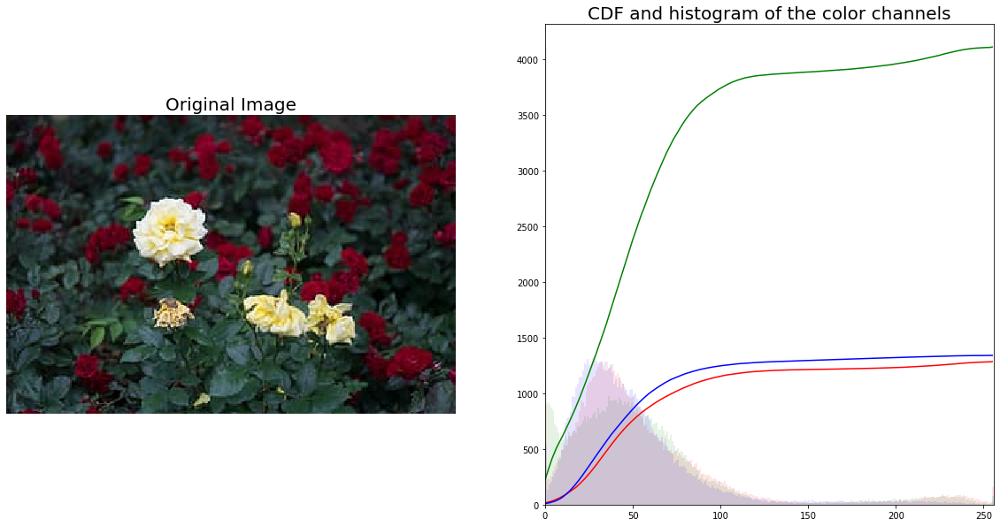

In [55]:
plot_img_hist(img, 'Original Image')

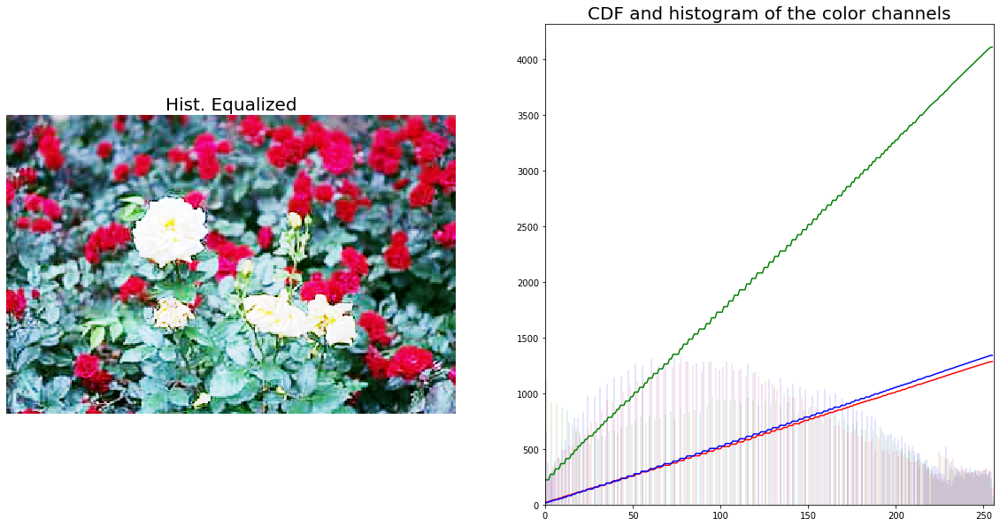

In [56]:
plot_img_hist(img2, 'Hist. Equalized')

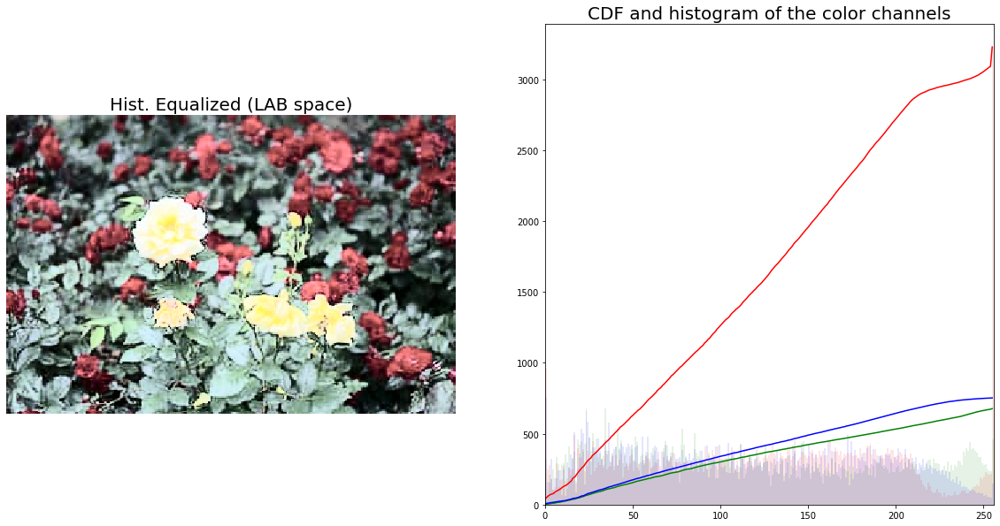

In [57]:
plot_img_hist(equ, 'Hist. Equalized (LAB space)')

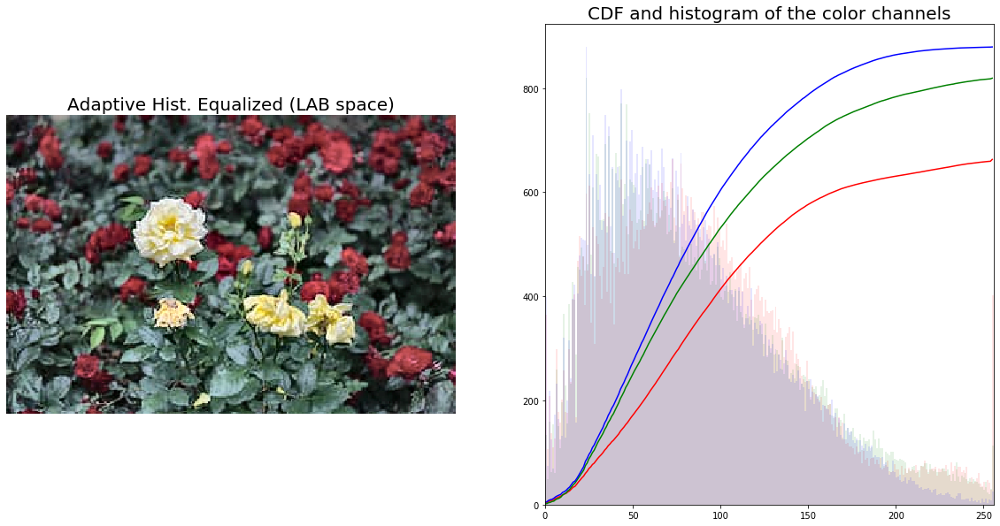

In [58]:
plot_img_hist(cl, 'Adaptive Hist. Equalized (LAB space)')

## 6. Fingerprint Cleaning and Minutiae feature extraction

### 6.1 Fingerprint Cleaning with Morphological operations

In [5]:
from skimage.io import imread
from skimage.color import rgb2gray
import numpy as np
import matplotlib.pylab as plt
from skimage.morphology import binary_opening, binary_closing, skeletonize, square
from scipy.ndimage import morphological_gradient
from skimage.filters import threshold_otsu

In [6]:
im = rgb2gray(imread('images/Img_05_09.jpg'))
im[im <= 0.5] = 0 # binarize
im[im > 0.5] = 1
im_o = binary_opening(im, square(2))
im_c = binary_closing(im, square(2))
im_oc = binary_closing(binary_opening(im, square(2)), square(3))
im_s = skeletonize(im_oc)
im_g = morphological_gradient(im_oc.astype(np.uint8), size=(2,2))

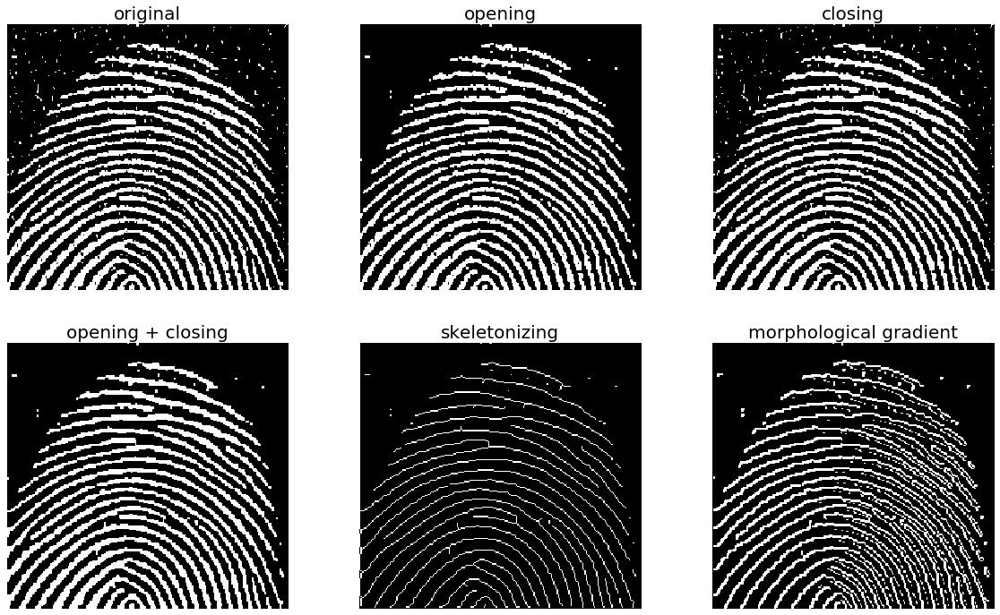

In [9]:
plt.figure(figsize=(20,12))
plt.gray()
plt.subplot(231), plot_image(im, 'original')
plt.subplot(232), plot_image(im_o, 'opening')
plt.subplot(233), plot_image(im_c, 'closing')
plt.subplot(234), plot_image(im_oc, 'opening + closing')
plt.subplot(235), plot_image(im_s, 'skeletonizing')
plt.subplot(236), plot_image(im_g, 'morphological gradient')
plt.show()

### 6.2 Feature (Minutiae) extraction from an enhanced fingerprint

In [10]:
from PIL import Image, ImageDraw

cells = [(-1, -1), (-1, 0), (-1, 1), (0, 1), (1, 1), (1, 0), (1, -1), (0, -1), (-1, -1)]

def minutiae_at(pixels, i, j):
    
    values = [pixels[i + k][j + l] for k, l in cells]
    crossings = 0
    for k in range(0, 8):
        crossings += abs(values[k] - values[k + 1])
    crossings /= 2
    if pixels[i][j] == 1:
        if crossings == 1:
            return "ending"
        if crossings == 3:
            return "bifurcation"
    return "none"

In [11]:
def calculate_minutiae(im):
    
    pixels = 255 - np.array(im).T
    pixels = 1.0*(pixels > 10)   
    (x, y) = im.size
    result = im.convert("RGB")
    draw = ImageDraw.Draw(result)
    colors = {"ending" : (150, 0, 0), "bifurcation" : (0, 150, 0)}
    ellipse_size = 2
    for i in range(1, x - 1):
        for j in range(1, y - 1):
            minutiae = minutiae_at(pixels, i, j)
            if minutiae != "none":
                draw.ellipse([(i - ellipse_size, j - ellipse_size), (i + ellipse_size, j + ellipse_size)], outline = colors[minutiae])
    del draw
    return result

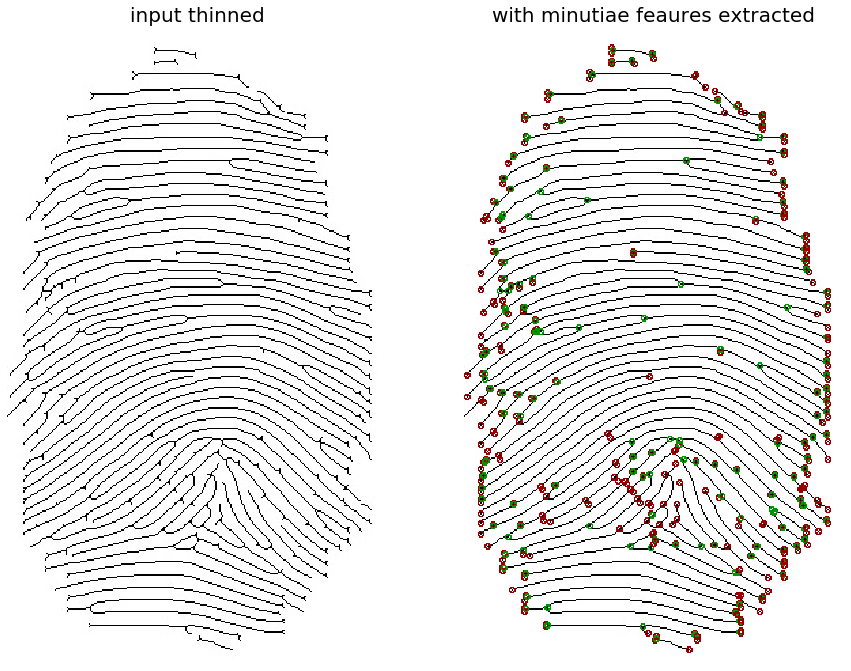

In [13]:
im = Image.open('images/Img_05_10.jpg').convert("L") # covert to grayscale
out = calculate_minutiae(im)
plt.figure(figsize=(15,12))
plt.gray()
plt.subplot(121), plot_image(im, 'input thinned')
plt.subplot(122), plot_image(out, 'with minutiae feaures extracted')
plt.show()

## 7. Edge Detection with LOG / Zero-Crossing, Canny vs. Holistically-Nested

In [1]:
from scipy.signal import convolve
from skimage.io import imread
from skimage.color import rgb2gray

img = rgb2gray(imread('images/Img_05_38.png'))
h, w = img.shape

In [2]:
kd1 = [[1, -1]]
kd2 = [[1, -2, 1]]
imgd1 = convolve(img, kd1, mode='same')
imgd2 = convolve(img, kd2, mode='same')

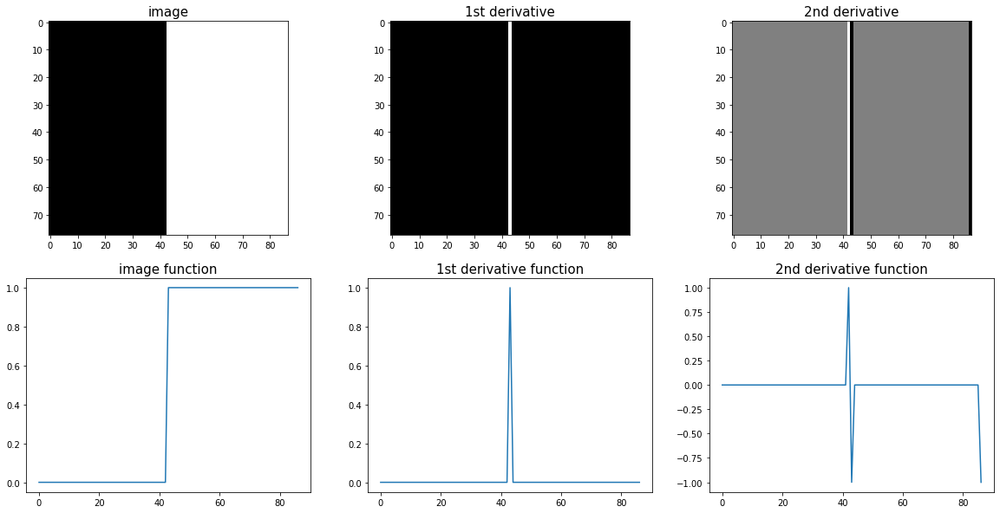

In [18]:
plt.figure(figsize=(20,10))
plt.gray()
plt.subplot(231), plt.imshow(img), plt.title('image', size=15)
plt.subplot(232), plt.imshow(imgd1), plt.title('1st derivative', size=15)
plt.subplot(233), plt.imshow(imgd2), plt.title('2nd derivative', size=15)
plt.subplot(234), plt.plot(range(w), img[0,:]), plt.title('image function', size=15)
plt.subplot(235), plt.plot(range(w), imgd1[0,:]), plt.title('1st derivative function', size=15)
plt.subplot(236), plt.plot(range(w), imgd2[0,:]), plt.title('2nd derivative function', size=15)
plt.show()

### 7.1 With LoG / Zero-Crossing

In [9]:
import numpy as np
from scipy import ndimage
from skimage.io import imread
import matplotlib.pyplot as plt
from skimage.color import rgb2gray

![](images/Img_05_18.jpg)

In [31]:
def any_neighbor_neg(img, i, j):
    for k in range(-1,2):
      for l in range(-1,2):
         if img[i+k, j+k] < 0:
            return True, img[i, j] - img[i+k, j+k]
    return False, None

In [32]:
def zero_crossing(img, th):
  out_img = np.zeros(img.shape)
  for i in range(1,img.shape[0]-1):
    for j in range(1,img.shape[1]-1):
      found, slope = any_neighbor_neg(img, i, j)
      if img[i,j] > 0 and found and slope > th:
        out_img[i,j] = 255
  return out_img

1.0


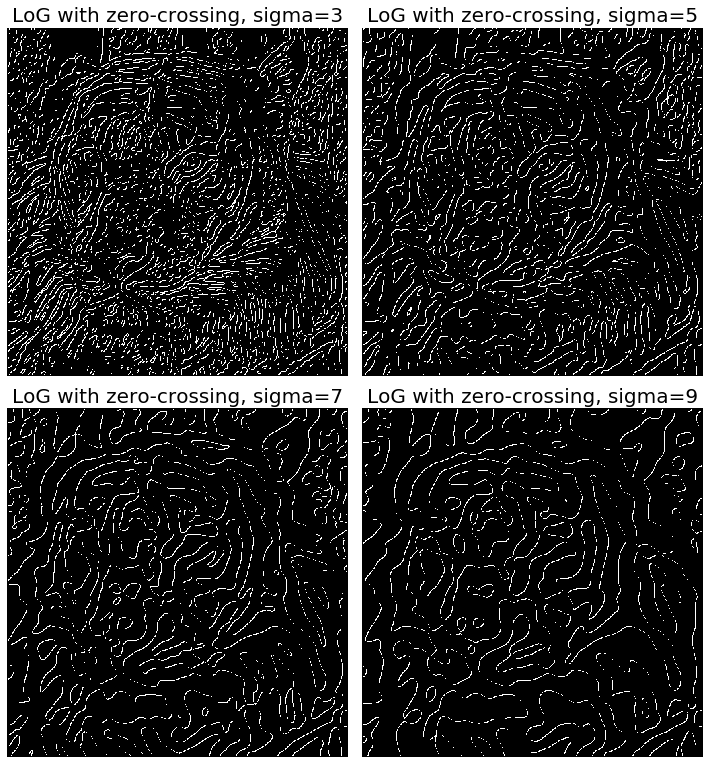

In [33]:
img = rgb2gray(imread('images/Img_05_18.jpg'))
#img = misc.imread('../new images/tagore.png')[...,3]
print(np.max(img))
fig = plt.figure(figsize=(10,16))
plt.subplots_adjust(0,0,1,0.95,0.05,0.05)
plt.gray() # show the filtered result in grayscale
for sigma, thres in zip(range(3,10,2), [1e-3, 1e-4, 1e-5, 1e-6]):
    plt.subplot(3,2,sigma//2)
    result = ndimage.gaussian_laplace(img, sigma=sigma)
    result = zero_crossing(result, thres)
    plt.imshow(result)
    plt.axis('off')
    plt.title('LoG with zero-crossing, sigma=' + str(sigma), size=20)

plt.tight_layout()
plt.show()

### 7.2 With Canny and Holistically-nested (deep learning model based)

#### Canny edge-detection


#### Holistically-nested edge detection

In [16]:
import cv2
import numpy as np
import matplotlib.pylab as plt

![](images/Img_05_46.png)

In [3]:
image = cv2.imread('images/Img_05_18.jpg')
(h, w) = image.shape[:2]

In [4]:
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
blurred = cv2.GaussianBlur(gray, (5, 5), 0)
canny = cv2.Canny(blurred, 80, 150)

In [5]:
# https://docs.opencv.org/master/dc/db1/tutorial_dnn_custom_layers.html
class CropLayer(object):
    def __init__(self, params, blobs):
        self.xstart = 0
        self.xend = 0
        self.ystart = 0
        self.yend = 0
        
    def getMemoryShapes(self, inputs):
        inputShape, targetShape = inputs[0], inputs[1]
        batchSize, numChannels = inputShape[0], inputShape[1]
        height, width = targetShape[2], targetShape[3]
        self.ystart = (inputShape[2] - targetShape[2]) // 2
        self.xstart = (inputShape[3] - targetShape[3]) // 2
        self.yend = self.ystart + height
        self.xend = self.xstart + width
        return [[batchSize, numChannels, height, width]]
    
    def forward(self, inputs):
        return [inputs[0][:,:,self.ystart:self.yend,self.xstart:self.xend]]

In [6]:
prototxt_path = "models/deploy.prototxt"
model_path = "models/hed_pretrained_bsds.caffemodel"

net = cv2.dnn.readNetFromCaffe(prototxt_path, model_path)

In [7]:
cv2.dnn_registerLayer('Crop', CropLayer)

In [8]:
blob = cv2.dnn.blobFromImage(image, scalefactor=1.0, size=(w, h), \
                             mean=(104.00698793, 116.66876762, 122.67891434), \
                             swapRB=False, crop=False)

In [37]:
net.setInput(blob)
hed = net.forward()
hed = cv2.resize(outs[i][0][0,:,:], (w, h))
hed = (255 * hed).astype("uint8")

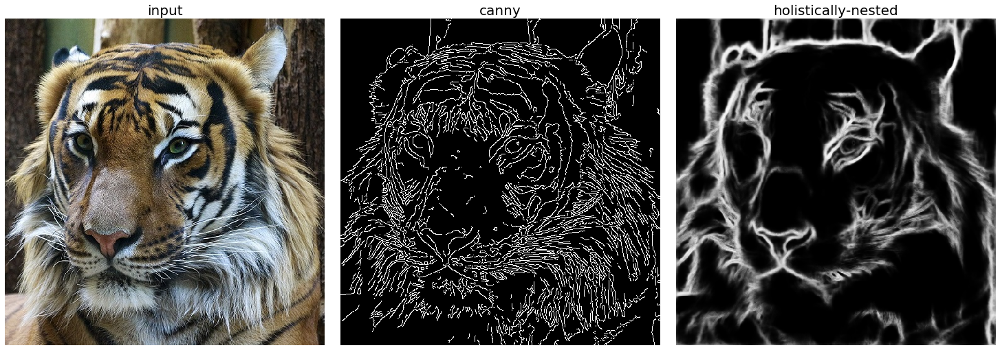

In [38]:
plt.figure(figsize=(20, 8))
plt.gray()
plt.subplots_adjust(0,0,1,0.975,0.05,0.05)
plt.subplot(131), plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB)), plt.axis('off'), plt.title('input', size=20)
plt.subplot(132), plt.imshow(canny), plt.axis('off'), plt.title('canny', size=20)
plt.subplot(133), plt.imshow(hed), plt.axis('off'), plt.title('holistically-nested', size=20)
plt.show()